In [5]:
import numpy as np
import pandas as pd
import tensorflow as tf
import glob
import cv2
import os
import numpy as np
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
import tensorflow
from tensorflow import keras
from keras import Sequential
from keras.models import *
from keras.layers import *
from keras.preprocessing import image
os.environ["SM_FRAMEWORK"] = "tf.keras"
import segmentation_models as sm

In [6]:
import glob
import cv2
import os
images_t = glob.glob("A.%20Segmentation/A. Segmentation/1. Original Images/a. Training Set/*.jpg")
images_t.sort()
images_v = glob.glob("A.%20Segmentation/A. Segmentation/1. Original Images/b. Testing Set/*.jpg")
images_v.sort()
masks_t = glob.glob("A.%20Segmentation/A. Segmentation/2. All Segmentation Groundtruths/a. Training Set/5. Optic Disc/*.tif")
masks_t.sort()
masks_v = glob.glob("A.%20Segmentation/A. Segmentation/2. All Segmentation Groundtruths/b. Testing Set/5. Optic Disc/*.tif")
masks_v.sort()
print(len(images_t))
print(len(images_v))
print(len(masks_t))
print(len(masks_v))

54
27
54
27


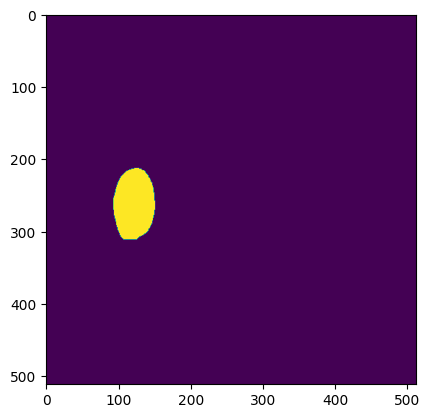

In [7]:
import os
image_t=[]
image_v=[]
mask_t=[]
mask_v=[]
for x in images_t:
  im=cv2.imread(x,cv2.IMREAD_COLOR)
  im=cv2.resize(im,(512,512))
  image_t.append(im)
for x in images_v:
  im=cv2.imread(x,cv2.IMREAD_COLOR)
  im=cv2.resize(im,(512,512))
  image_v.append(im)
for y in masks_t:
  ma=cv2.imread(y,cv2.IMREAD_GRAYSCALE)
  ma=cv2.resize(ma,(512,512),interpolation = cv2.INTER_NEAREST)
  plt.imshow(ma)
  mask_t.append(ma)
for y in masks_v:
  ma=cv2.imread(y,cv2.IMREAD_GRAYSCALE)
  ma=cv2.resize(ma,(512,512),interpolation = cv2.INTER_NEAREST)
  plt.imshow(ma)
  mask_v.append(ma)

In [8]:
print(len(image_t),len(mask_t))
img_array_t=np.array(image_t)
mask_array_t=np.array(mask_t)
mask_array_t=np.expand_dims(mask_array_t,axis=-1)
img_array_v=np.array(image_v)
mask_array_v=np.array(mask_v)
mask_array_v=np.expand_dims(mask_array_v,axis=-1)
mask_array_t=mask_array_t.astype(np.float32)
mask_array_v=mask_array_v.astype(np.float32)
print(img_array_t.shape)
print(mask_array_t.shape)
print((np.unique(mask_array_t)))
print(mask_array_t.shape)

54 54
(54, 512, 512, 3)
(54, 512, 512, 1)
[ 0. 76.]
(54, 512, 512, 1)


In [9]:
a=np.where(mask_array_t==76)
mask_array_t[a]=1
print(np.unique(mask_array_t))
b=np.where(mask_array_v==76)
mask_array_v[b]=1
print(np.unique(mask_array_v))

[0. 1.]
[0. 1.]


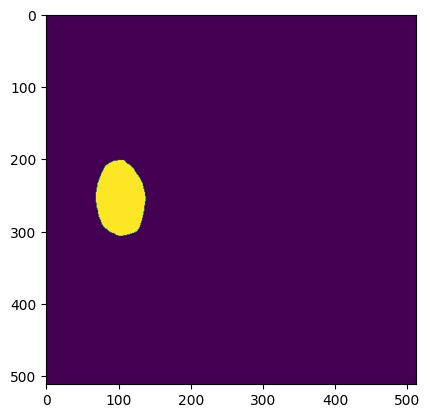

In [10]:
plt.imshow(mask_array_t[20])

In [11]:
import segmentation_models as sm
from segmentation_models import Unet
from segmentation_models import get_preprocessing
from tensorflow.keras.utils import plot_model
import tensorflow as tf

sm.set_framework('tf.keras')
sm.framework()
BACKBONE = 'efficientnetb4'

preprocess_input = get_preprocessing(BACKBONE)
model = Unet(BACKBONE, input_shape=(512,512,3), encoder_weights='imagenet', activation='sigmoid')



71892840/71892840 [==============================] - 4s 0us/step


In [12]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=sm.losses.DiceLoss(),
              metrics=['binary_accuracy', tf.keras.metrics.Recall(), tf.keras.metrics.Precision(),
                       tf.keras.metrics.AUC(), sm.metrics.IOUScore(), sm.metrics.FScore()])


In [13]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

mp = ModelCheckpoint('best_seg_model.keras', save_best_only=True, monitor='val_iou_score')
lrp = ReduceLROnPlateau(monitor="iou_score", factor=0.1, patience=2)
es = EarlyStopping(patience=2, monitor='iou_score')
call = [lrp]

history = model.fit(img_array_t,
                    mask_array_t,
                    batch_size=1,
                    epochs=10,
                    validation_data=(img_array_v, mask_array_v),
                    callbacks=call)

Epoch 1/10


54/54 [==============================] - 51s 559ms/step - loss: 0.7454 - binary_accuracy: 0.9562 - recall: 0.9780 - precision: 0.2891 - auc: 0.9916 - iou_score: 0.1546 - f1-score: 0.2546 - val_loss: 0.9609 - val_binary_accuracy: 0.1623 - val_recall: 1.0000 - val_precision: 0.0202 - val_auc: 0.6090 - val_iou_score: 0.0200 - val_f1-score: 0.0391 - lr: 0.0010
Epoch 2/10
54/54 [==============================] - 27s 510ms/step - loss: 0.2026 - binary_accuracy: 0.9964 - recall: 0.9434 - precision: 0.8693 - auc: 0.9912 - iou_score: 0.6737 - f1-score: 0.7974 - val_loss: 0.9405 - val_binary_accuracy: 0.4594 - val_recall: 1.0000 - val_precision: 0.0310 - val_auc: 0.8459 - val_iou_score: 0.0307 - val_f1-score: 0.0595 - lr: 0.0010
Epoch 3/10
54/54 [==============================] - 28s 520ms/step - loss: 0.0758 - binary_accuracy: 0.9979 - recall: 0.9561 - precision: 0.9314 - auc: 0.9941 - iou_score: 0.8623 - f1-score: 0.9242 - val_loss: 0.8716 - val_binary_accuracy: 0.7988 - val_recal

In [17]:
model.save('OD_segmentation.h5')

C:\Users\Sid\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 5s 5s/step


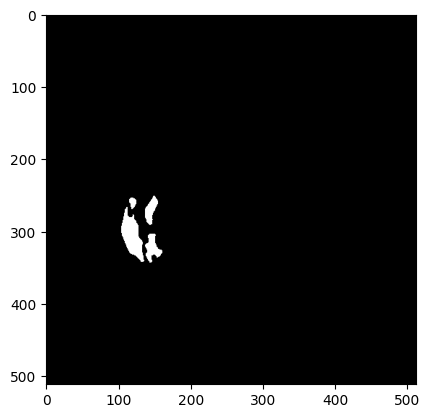

In [14]:
test_preds = model.predict(img_array_v)
preds_test_thresh = (test_preds >= 0.5).astype(np.uint8)
test_img = preds_test_thresh[5, :, :, 0]
plt.imshow(test_img, cmap='gray')

C:\Users\Sid\AppData\Local\Temp\ipykernel_22028\2704317335.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15, 15))


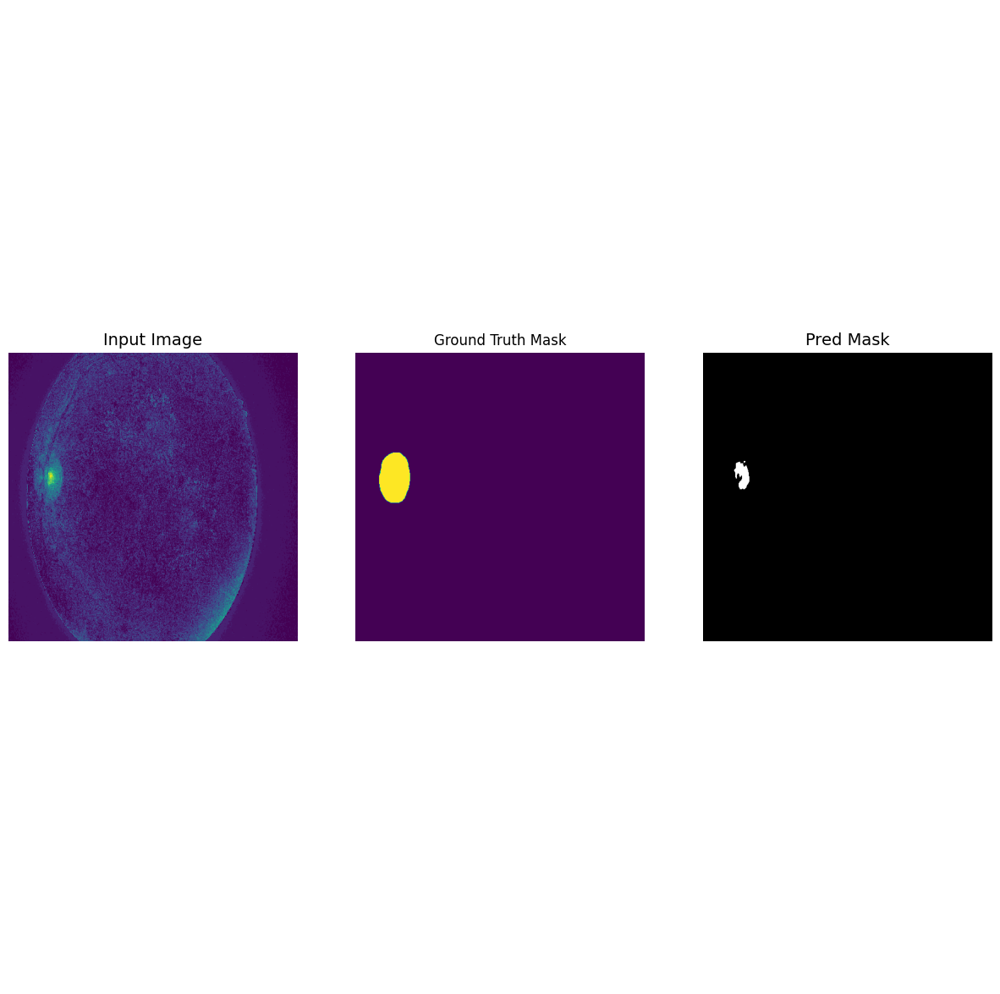

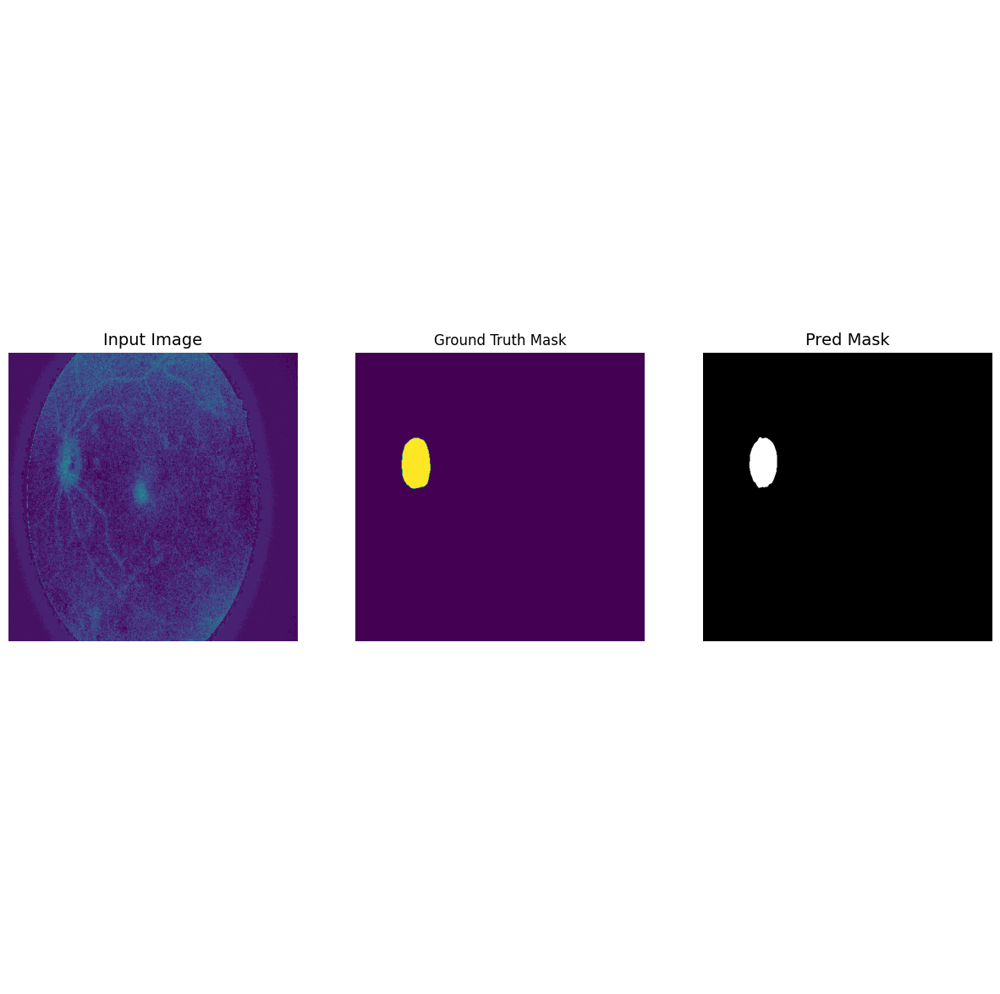

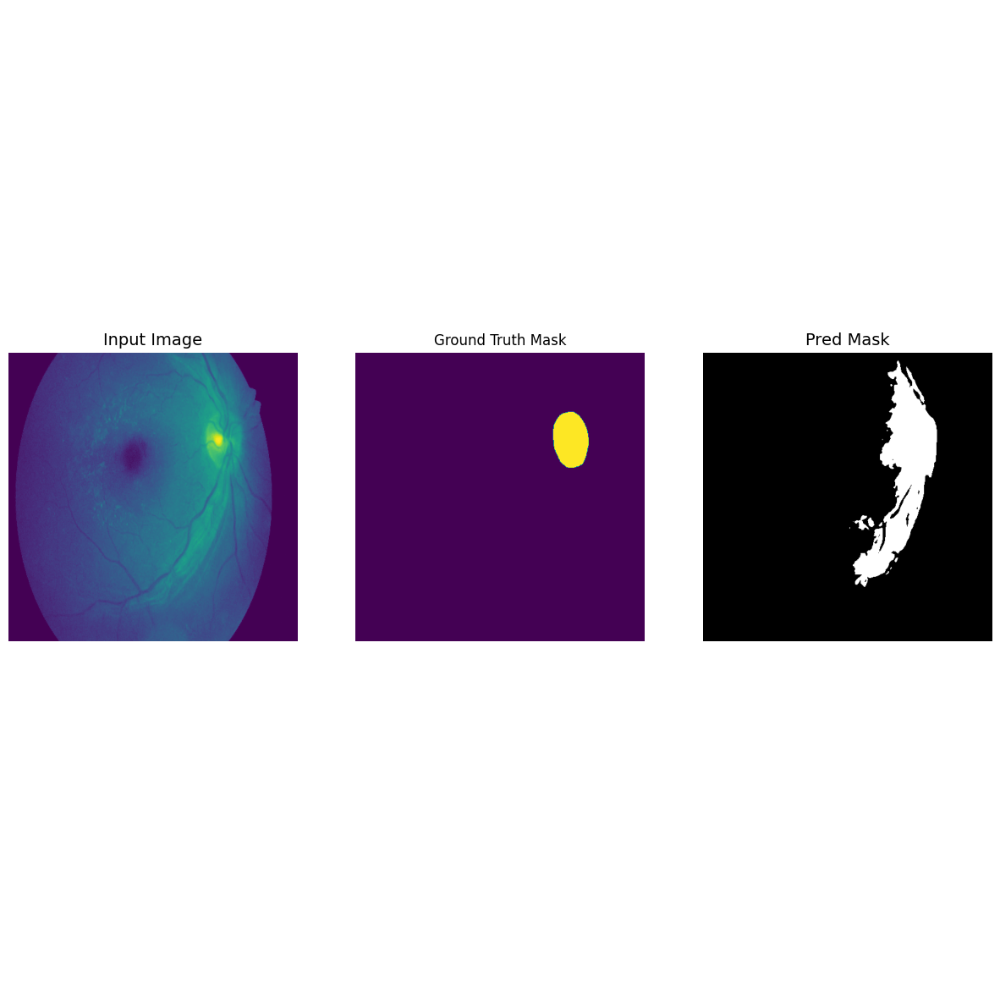

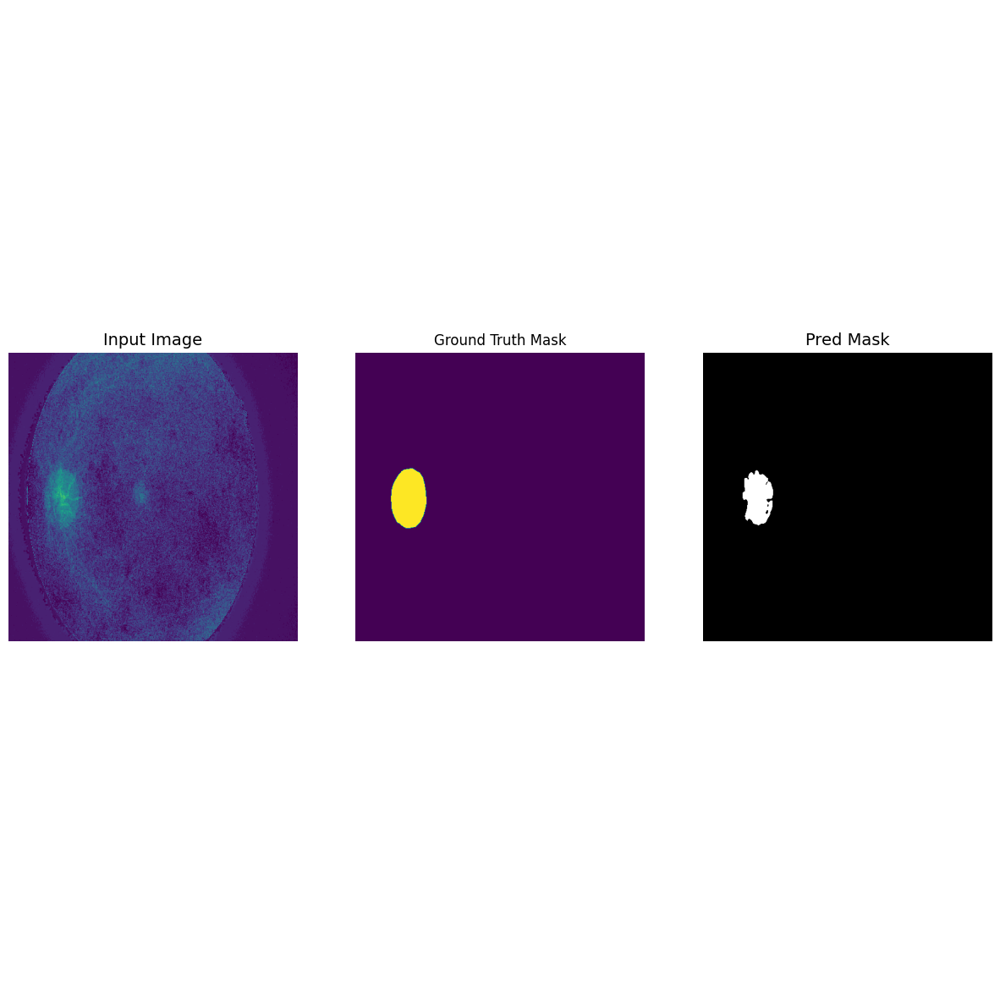

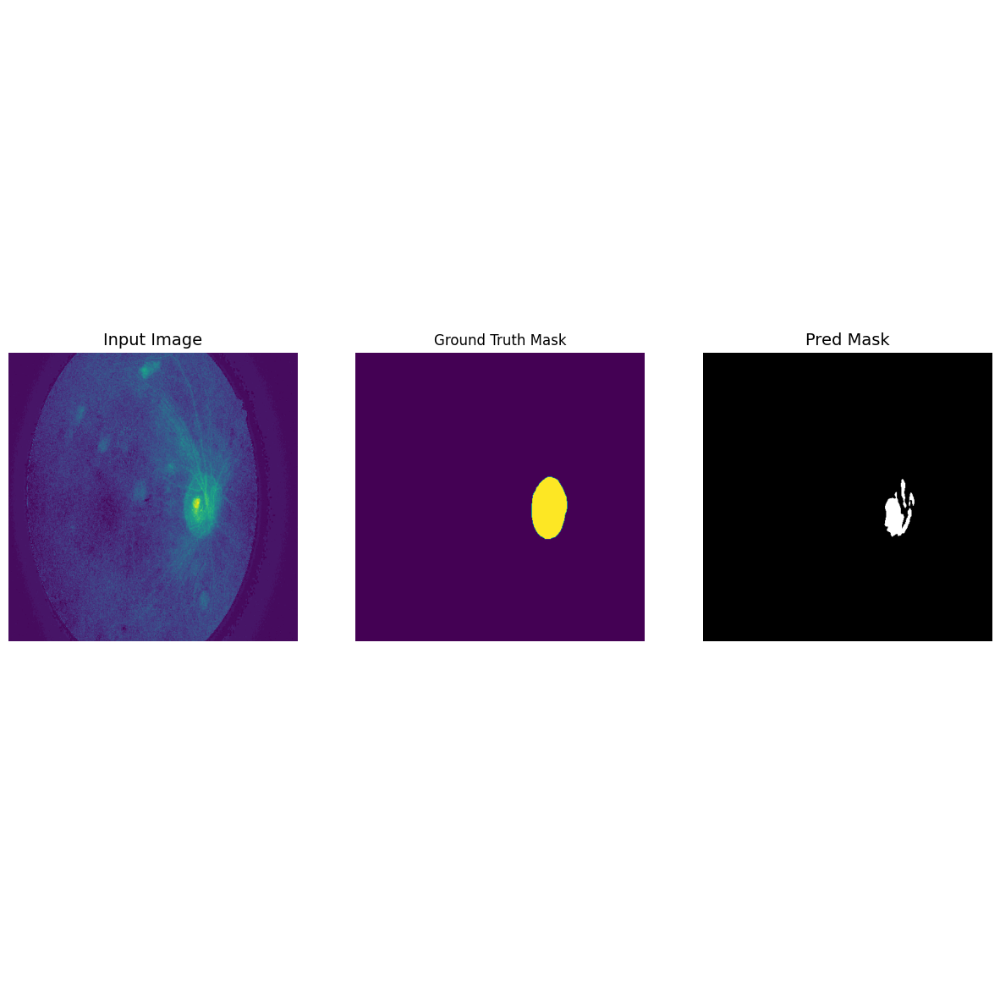

...

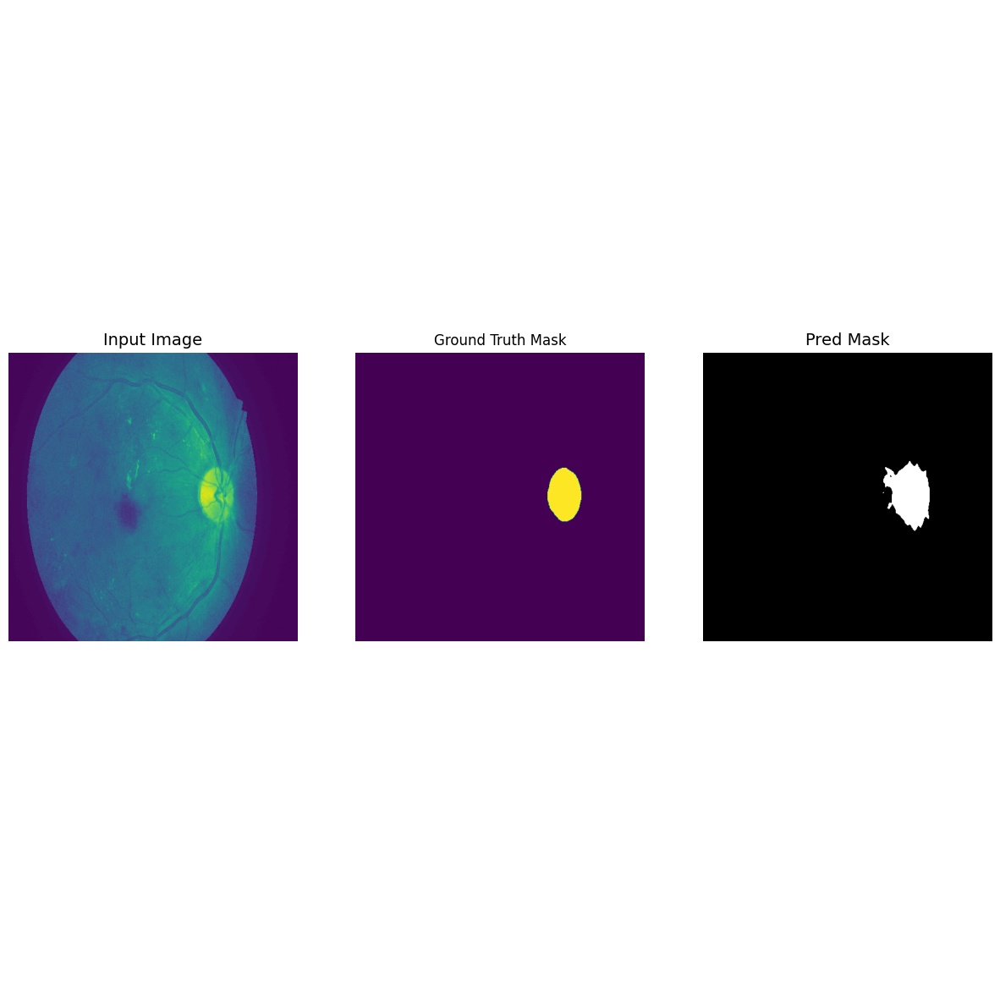

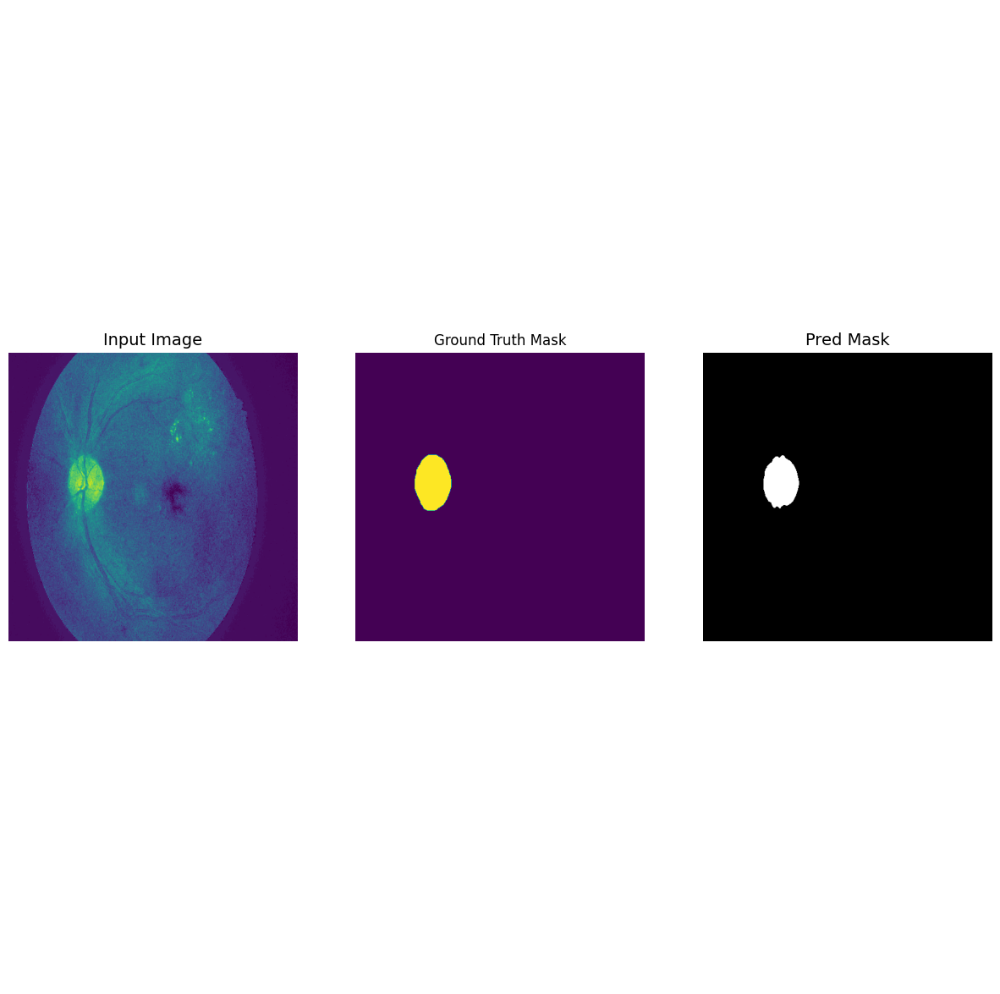

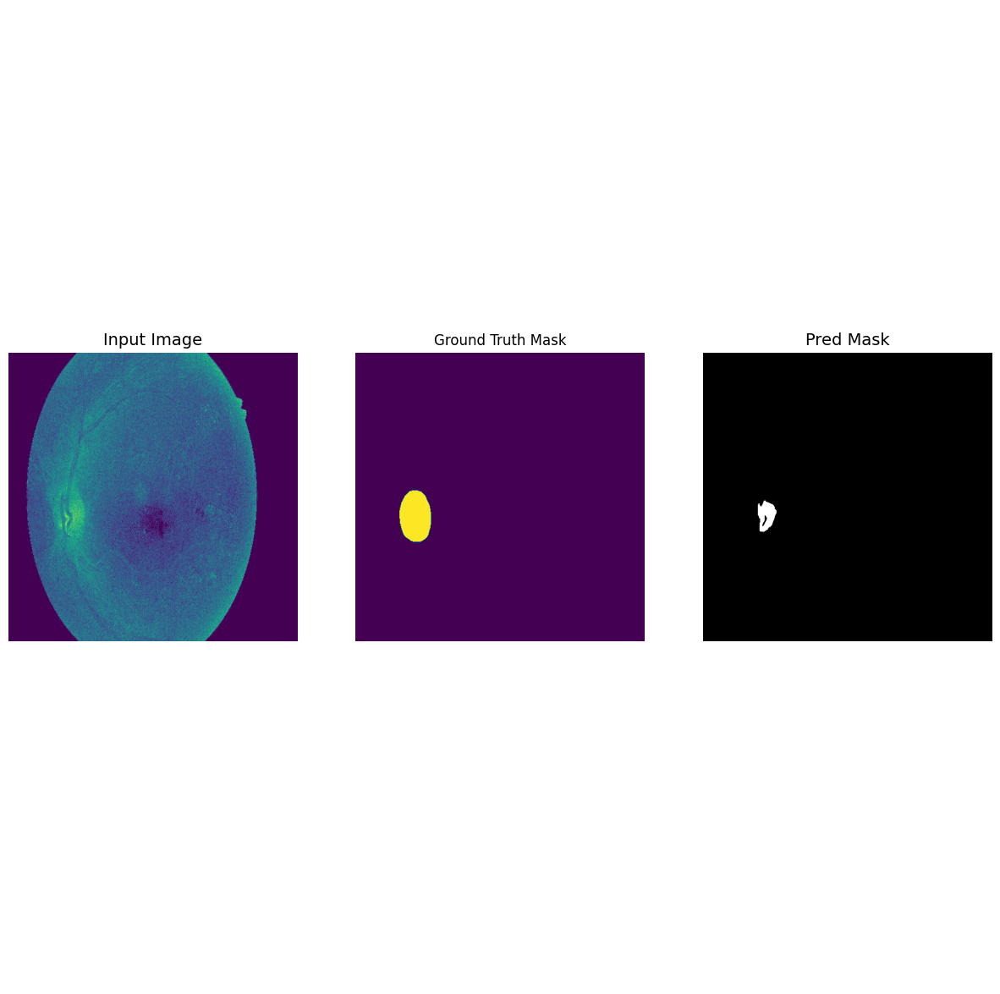

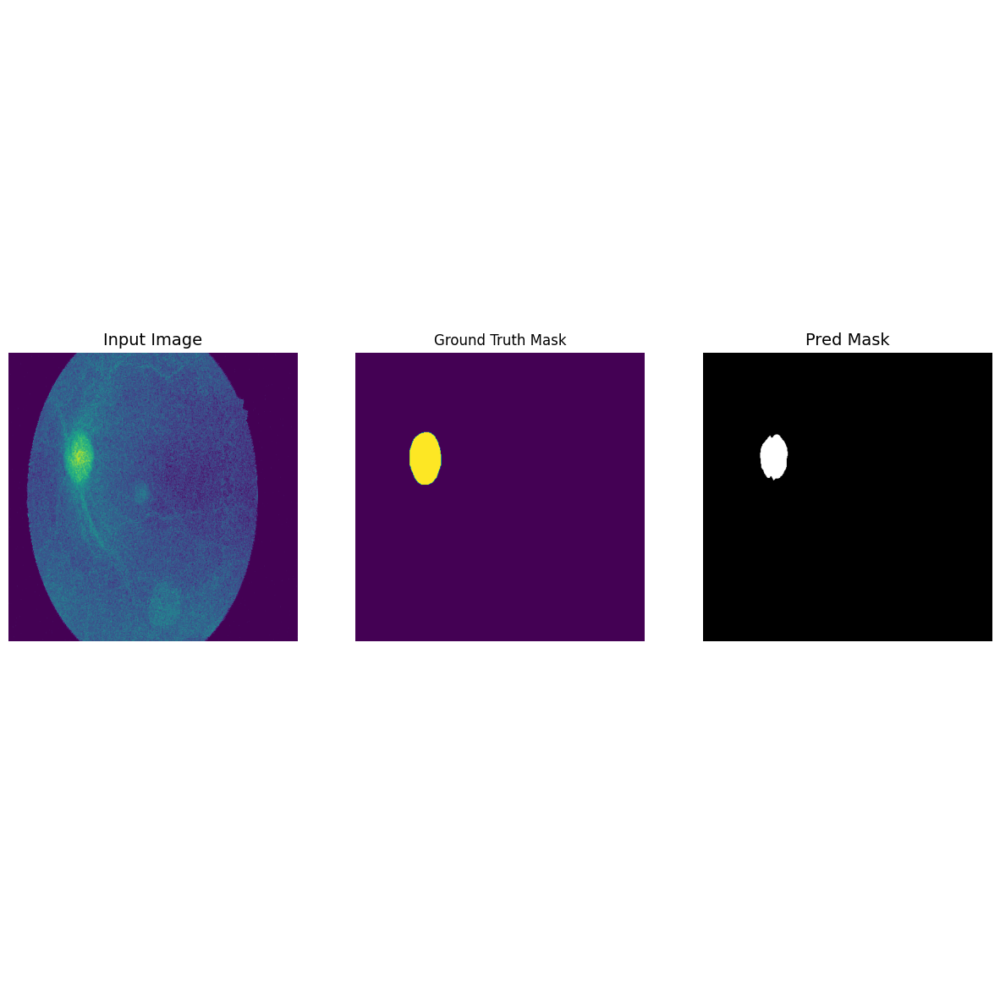

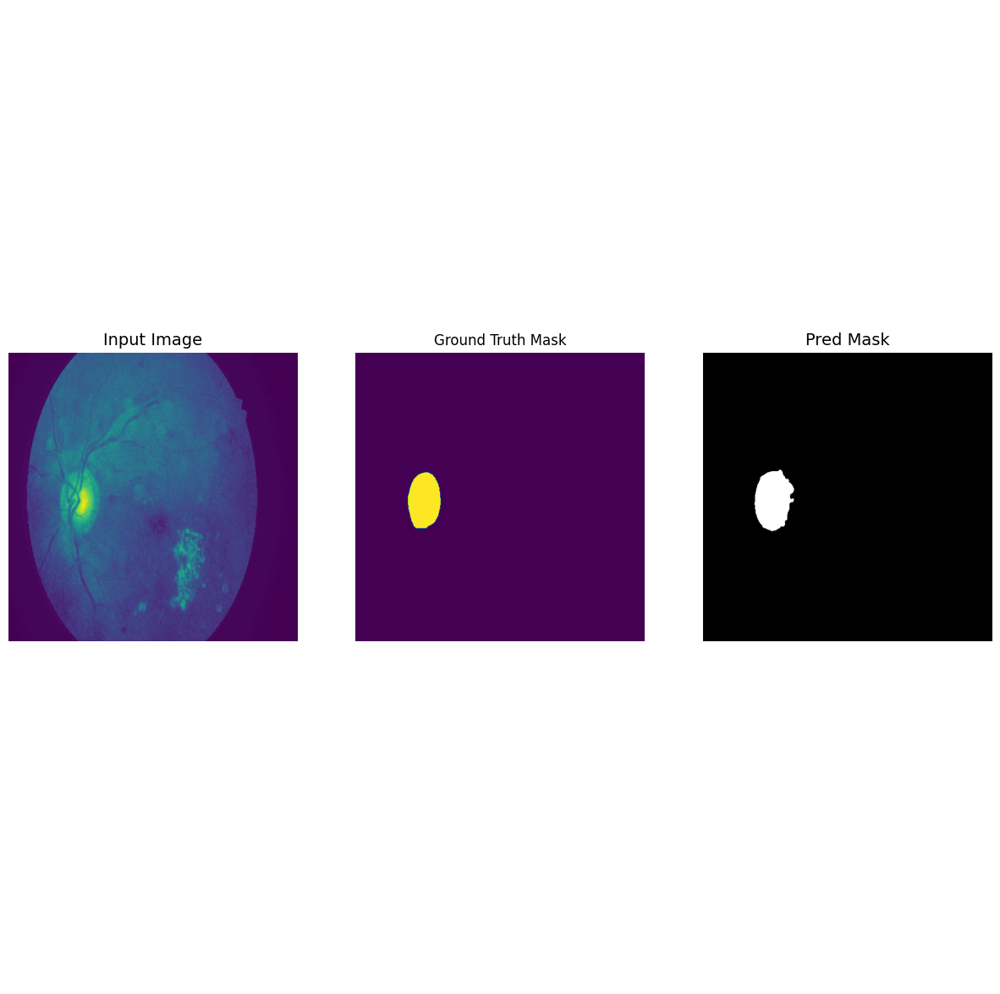

In [15]:
for i in range(0, len(img_array_v)):
    plt.figure(figsize=(15, 15))
    plt.axis('off')

    test_image = img_array_v[i, :, :, 0]
    plt.subplot(1, 3, 1)
    plt.imshow(test_image)
    plt.title('Input Image', fontsize=14)
    plt.axis('off')

    test_mask = mask_array_v[i, :, :]
    plt.subplot(1, 3, 2)
    plt.imshow(test_mask)
    plt.title('Ground Truth Mask')
    plt.axis('off')

    test_mask = preds_test_thresh[i, :, :, 0]
    plt.subplot(1, 3, 3)
    plt.imshow(test_mask, cmap='gray')
    plt.title('Pred Mask', fontsize=14)
    plt.axis('off')

plt.show()


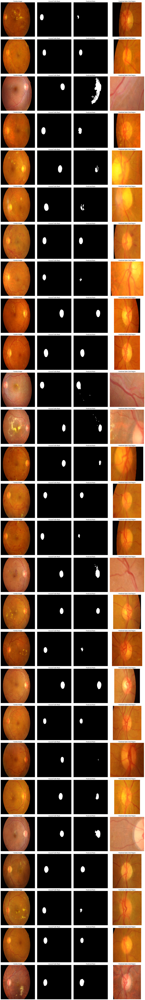

In [16]:
import cv2
import matplotlib.pyplot as plt

# Define the number of images in the testing set
num_images = len(img_array_v)

# Create a figure with subplots
fig, axs = plt.subplots(num_images, 4, figsize=(20, 5 * num_images))

for i in range(num_images):
    # Convert the image from BGR to RGB
    img_array_v[i] = cv2.cvtColor(img_array_v[i], cv2.COLOR_BGR2RGB)

    # Display the full fundus image
    axs[i, 0].imshow(img_array_v[i])
    axs[i, 0].set_title(f'Fundus Image')

    # Display the ground truth mask
    axs[i, 1].imshow(mask_array_v[i][:, :, 0], cmap='gray')
    axs[i, 1].set_title(f'Ground Truth Mask')

    # Display the predicted mask
    axs[i, 2].imshow(preds_test_thresh[i], cmap='gray')
    axs[i, 2].set_title(f'Predicted Mask')

    # Apply the predicted mask to the original image
    predicted_disk = cv2.bitwise_and(img_array_v[i], img_array_v[i], mask=preds_test_thresh[i])

    # Find contours around the predicted disk
    contours, _ = cv2.findContours(preds_test_thresh[i], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Get the bounding box around the predicted disk
    if contours:
        x, y, w, h = cv2.boundingRect(contours[0])

        # Crop a region around the predicted disk
        surrounding_region = img_array_v[i][max(0, y - 50):y + h + 50, max(0, x - 50):x + w + 50]

        # Display the surrounding region around the predicted optical disk
        axs[i, 3].imshow(surrounding_region)
        axs[i, 3].set_title(f'Predicted Optic Disk Region')

    # Turn off axis for all subplots
    for j in range(4):
        axs[i, j].axis('off')

plt.tight_layout()
plt.show()